# Preparing & read data

In [1]:
import airportsdata
import numpy as np
import networkx as nx
import pandas as pd
import itertools
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import math
import sys, time
import random

airports = airportsdata.load()

In [20]:
g_2019 = nx.read_gml("flightlist_20191201_20191231.gml", label="label")
g_2020_apr = nx.read_gml("flightlist_20200401_20200430.gml", label="label")
g_2020_apr.remove_edges_from(nx.selfloop_edges(g_2020_apr))
g_2019.remove_edges_from(nx.selfloop_edges(g_2019))

# 1 Airline Network Visualization

## 1.1 define function to draw on map

In [3]:
def draw_flights_on_map(airline_network, axis,node_size,node_color='red', draw_node=True, draw_edge=True):
    m = Basemap()
    pos = {}
    for i in airline_network:
        longtitude = airports[i]['lon']
        latitude = airports[i]['lat']
        map_long, map_lat = m(longtitude,latitude)
        pos[i] = (longtitude, latitude)
    n_flights = np.fromiter(nx.get_edge_attributes(airline_network, 'value').values(),dtype=int)
    rgba_colors = list(n_flights/np.max(n_flights))
    # edges,n_flights = zip(*nx.get_edge_attributes(g,'value').items())
    if draw_node:
        nx.draw_networkx_nodes(airline_network,pos,
                               nodelist=airline_network.nodes(),
                               node_size=node_size,
                               node_color=node_color,
                               alpha=0.3,
                              ax=axis)
    if draw_edge:
        nx.draw_networkx_edges(airline_network,pos,
                               edgelist = airline_network.edges(),
                               edge_color=rgba_colors,
                               alpha=0.1,
                              ax=axis)
    m.drawcoastlines(ax=axis)

    m.drawcountries(ax=axis)


## 1.2 Description of the overall flights on Dec 2019 and Apr 2020

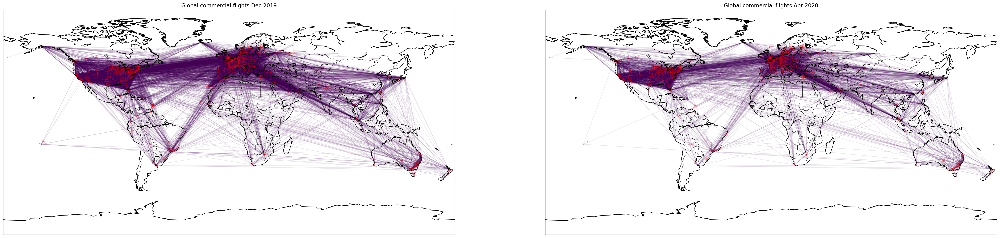

In [4]:
fig, axs = plt.subplots(1,2, figsize=(40,20), dpi=200)

draw_flights_on_map(g_2019,axs[0],3)
axs[0].set_title("Global commercial flights Dec 2019")

axs[1].set_title("Global commercial flights Apr 2020")
draw_flights_on_map(g_2020_apr,axs[1],3)


## 1.3 Network Indicators

In [5]:
import pandas as pd
import networkx as nx
import numpy as np

g_2019 = nx.read_gml("flightlist_20191201_20191231.gml", label="label")
g_2020_apr = nx.read_gml("flightlist_20200401_20200430.gml", label="label")
g_2020_apr.remove_edges_from(nx.selfloop_edges(g_2020_apr))
g_2019.remove_edges_from(nx.selfloop_edges(g_2019))


def Get_Graph_index(G):
    N=nx.number_of_nodes(G) 
    M=nx.number_of_edges(G) 
    
    degree = dict(nx.degree(G))
    aver_d = np.mean(list(degree.values()))
    
    density=nx.density(G)
    ncc = nx.number_connected_components(G)
    # nscc = nx.number_strongly_connected_components(G)
    clus = nx.average_clustering(G)
    
    # if nx.is_connected(G):
    #     dia = nx.diameter(G)
    #     path = nx.average_shortest_path_length(G)
    # else:
    #     G1=max((G.subgraph(c) for c in nx.connected_components(G)),key=len)
    #     dia = nx.diameter(G1)
    #     path = nx.average_shortest_path_length(G1)
    
    trans = nx.transitivity(G)
    reci = nx.reciprocity(G)
    coeff = nx.degree_pearson_correlation_coefficient(G, x='out', y='in', weight='weight', nodes=None)
    
    dfi = pd.DataFrame({'NetType':['unweighted'],'Nodes':[N],'Edges':[M],
                             'Average Degree':[aver_d],
                             'Density':[density],
                              # 'Diameter':[dia],
                             'Connected Components':[ncc],
                             # 'strongly Connected_Components':[nscc],
                             'average_clustering':[clus],
                             # 'average_shortest_path_length':[path],
                             'Transitivity':[trans],
                             'Reciprocity ':[reci],
                             'pearson_coeff':[coeff]})
    dfi=dfi.T
    return dfi


df1=Get_Graph_index(g_2019)
df1.columns=['Dec2019(Pre-covid)']

df2=Get_Graph_index(g_2020_apr)
df2.columns=['Apr2020(Post-covid)']

dff=pd.concat([df1,df2],axis=1)

dff

,Dec2019(Pre-covid),Apr2020(Post-covid)
NetType,unweighted,unweighted
Nodes,1590,1474
Edges,25321,13552
Average Degree,31.850314,18.38806
Density,0.020044,0.012483
Connected Components,52,68
average_clustering,0.482097,0.387841
Transitivity,0.373205,0.334395
Reciprocity,0.0,0.0
pearson_coeff,-0.009692,0.117618


# 2 Degree Distribution

Dataset: Flight dataset Dec.2019
The average degree is: 31.850314465408804


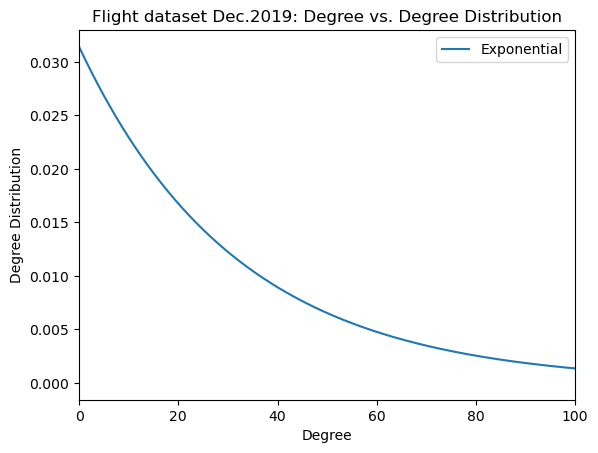

--------------------------------------------------------------------
Dataset: Flight dataset Apr.2020
The average degree is: 18.388059701492537


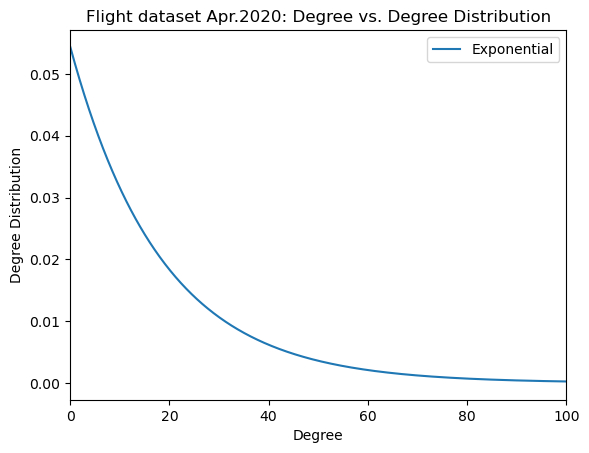

--------------------------------------------------------------------


In [6]:
# The WAN data reveals a scale-free behavior with an exponential cutoff
# the exponential distribution with mean value equal to ⟨𝑘⟩. 

def expo(k, lamda):
    return lamda**(-1) * np.exp(-k/lamda)

def myfunc(x,alpha):
    return x**(-alpha)

# Super mighty function ......
def dist_ave_pow(name, graph):
    print("Dataset: " + name)
    #Load degrees
    g_degrees = graph.degree()
    degrees = [ g_degrees[i] for i in graph.nodes() ]

    #Compute ave. degres
    sum_deg = []
    for i in degrees:
        sum_deg.append(i)
    ave_degree = sum(sum_deg) / len(sum_deg)
    print("The average degree is: " + str(ave_degree))

    # for expo
    k = np.sort(np.asarray([d for d in dict(graph.degree()).values()]), )
    spacing = np.linspace(min(k),max(k),len(k))

    #Create the plot
    # my_bins = np.logspace(np.log10(min(degrees)),np.log10(max(degrees) +1), 15 )
    # _ = plt.hist(degrees, bins = my_bins, density = True, label="Degree Dist.") 
    plt.plot(spacing,expo(spacing,ave_degree), label="Exponential")
    plt.title(name + ": Degree vs. Degree Distribution")
    plt.xlabel("Degree")
    plt.ylabel("Degree Distribution")
    
    plt.xlim([0, 100])
    plt.legend()
    plt.show()

    #Division between different datasets
    print("--------------------------------------------------------------------")


dist_ave_pow("Flight dataset Dec.2019", g_2019)
#dist_ave_pow("Flight dataset Feb.2020", flight_feb_20)
dist_ave_pow("Flight dataset Apr.2020", g_2020_apr)

# 3 Clustering Analysis

## 3.1 Define function for Clustering Analysis

In [7]:
# Get euclidean distance between two airports
def get_distance_km(a_i, a_j, mode):
    if mode == 'weighted':
        long_1 = airports[a_i]['lon']
        long_2 = airports[a_j]['lon']
        lat_1 = airports[a_i]['lat']
        lat_2 = airports[a_j]['lat']
        return math.sqrt(((long_2 - long_1)**2) + ((lat_2 - lat_1)**2))
    elif mode == 'topology':
        return 1
    else:
        raise Exception('Unknown calculation mode')
get_distance_km('LIMC','LSZH','topology') 

1

In [8]:
# Calculate s_i
def s_i(g, node_name, mode):
    result = []
    for n in g[node_name]:
        result.append(1.0/get_distance_km(node_name, n, mode))
    if np.array(result).sum() == 0:
        return 1
    else:
        return np.array(result).sum()
s_i(g_2019,'LSZH','weighted')

43.473867900755685

0

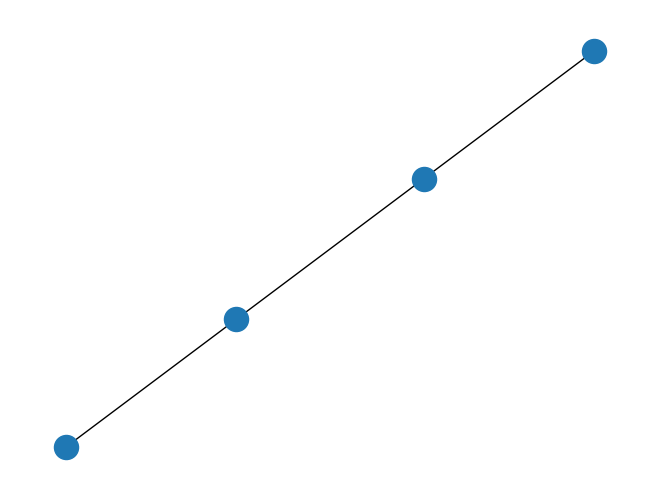

In [9]:
# Helper function determining if three nodes forms a triangle
def is_triangle(g, n_i, n_j, n_h):
    return 1 if n_i in g[n_j] and n_j in g[n_h] and n_h in g[n_i] else 0
G=nx.Graph()
G.add_edge('a','b',weight=1)
G.add_edge('a','c',weight=1)
G.add_edge('c','d',weight=1)
nx.draw(G)
is_triangle(G,'a','b','c')

In [10]:
def get_clustering_coefficient(g, mode='weighted'):
    result = {}
    for n_i in g:
        sum_of_neigh = 0
        neighbor_combs = [x for x in itertools.combinations(g[n_i], r=2)]
        for (n_j, n_h) in neighbor_combs:
            sum_of_neigh += (1.0/get_distance_km(n_i, n_j, mode) + 1.0/get_distance_km(n_i, n_h, mode)) / 2 * is_triangle(g, n_i, n_j, n_h)
        if s_i(g, n_i, mode) == 0:
            print("s_i is zero")
        i_degree_minus_1 = 1 if g.degree(n_i) - 1 == 0 else g.degree(n_i) - 1
        sum_of_neigh *= 1/(s_i(g, n_i, mode) * i_degree_minus_1)
        result[n_i] = sum_of_neigh
    return result

In [11]:
def draw_cluster_and_get_nodes_list(g, name, draw_edge):
    C_w = get_clustering_coefficient(g)
    C_c = get_clustering_coefficient(g, mode='topology')
    C_w_arr = pd.Series(C_w)
    C_c_arr = pd.Series(C_c)
    nodes_peri = C_w_arr.index[(C_w_arr == 0) & (C_w_arr == C_c_arr)].to_list()
    nodes_local = C_w_arr.index[C_w_arr > C_c_arr].to_list()
    nodes_global = C_w_arr.index[C_w_arr <= C_c_arr].to_list()
    fig, axs = plt.subplots(3, figsize=(30,40), dpi=200)
    fig.suptitle(f"Clusters of Airports {name}")
    axs[0].set_title("Global")
    draw_flights_on_map(g.subgraph(nodes_global), axs[0], 70,draw_edge=draw_edge, node_color='red')
    axs[1].set_title("Local")
    draw_flights_on_map(g.subgraph(nodes_local), axs[1], 70,draw_edge=draw_edge, node_color='green')
    axs[2].set_title("Peripheral")
    draw_flights_on_map(g.subgraph(nodes_peri), axs[2], 200,draw_edge=draw_edge, node_color='orange')
    plt.show()
    return nodes_peri, nodes_local, nodes_global

## 3.2 Plot of peripheral, local, global clusters Dec 2019

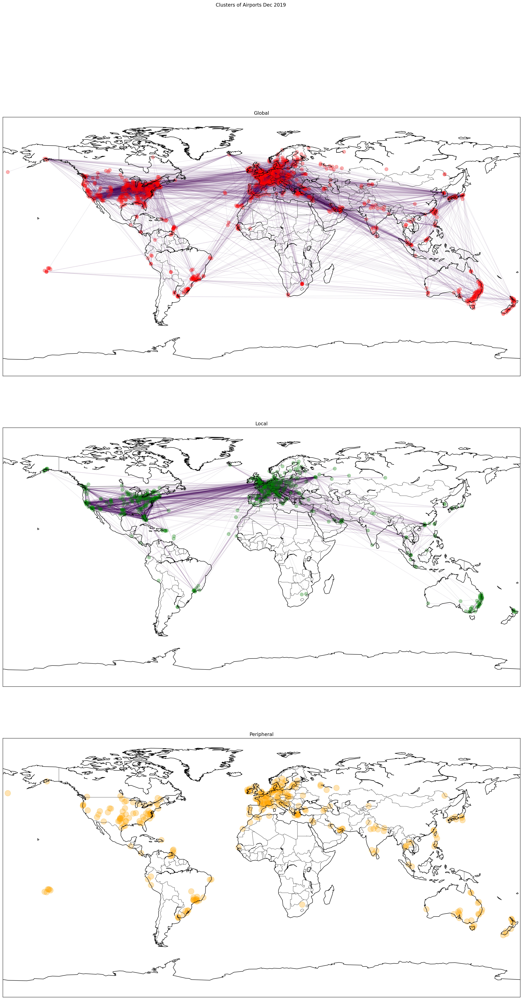

In [12]:
nodes_peri_2019, nodes_local_2019, nodes_global_2019 = draw_cluster_and_get_nodes_list(g_2019,'Dec 2019',True)

# $C_w$ 2019

In [13]:
get_clustering_coefficient(g_2019)

{'PAMR': 0.32204565683170194,
 'KDVT': 0.24549874154000584,
 'KPHX': 0.17760167640342983,
 'KSAC': 0.3098215325400189,
 'KSMF': 0.22830003804914278,
 'KPIE': 0.21685980024940446,
 'KATL': 0.13371549279846318,
 'KPDK': 0.19490782051499955,
 'KMKC': 0.21572906578031745,
 'KVCT': 0.5,
 'KABQ': 0.292243242072884,
 'KDAL': 0.2339521800572784,
 'KHOU': 0.21617802907918557,
 'KIND': 0.1594293076123697,
 'KMCI': 0.294902797092897,
 'KORL': 0.26237176965708764,
 'KHSV': 0.21701219470580332,
 'KRDU': 0.17128800060435376,
 'KTYR': 0.35399553388066524,
 'PAED': 0.170496023260641,
 'KMDW': 0.17962165797060758,
 'KMSN': 0.22778450175559373,
 'BIKF': 0.14583271823752877,
 'CYYC': 0.1929237956994045,
 'CYYZ': 0.10213729759165643,
 'EDDF': 0.11854047400507248,
 'EGCC': 0.1652175618133194,
 'EGKK': 0.21329029232110017,
 'KACK': 0.3080110155635054,
 'KADS': 0.28963435079314603,
 'KBED': 0.1411571786570482,
 'KBKL': 0.23326689481204285,
 'KBOS': 0.13271939401518726,
 'KBUF': 0.1534111537839712,
 'KBWI': 0

# $C_c$ 2019

In [14]:
get_clustering_coefficient(g_2019, 'topology')

{'PAMR': 0.2222222222222222,
 'KDVT': 0.23886328725038403,
 'KPHX': 0.2178030303030303,
 'KSAC': 0.3129445234708393,
 'KSMF': 0.3030694205393,
 'KPIE': 0.18359208090015666,
 'KATL': 0.13265125343254494,
 'KPDK': 0.18554671135316297,
 'KMKC': 0.21885714285714286,
 'KVCT': 0.5,
 'KABQ': 0.31110154905335624,
 'KDAL': 0.18982127433393128,
 'KHOU': 0.19128436668547932,
 'KIND': 0.18666898712147578,
 'KMCI': 0.29508480443059887,
 'KORL': 0.20147832396154544,
 'KHSV': 0.290391156462585,
 'KRDU': 0.20351737186102511,
 'KTYR': 0.3470588235294118,
 'PAED': 0.08888888888888889,
 'KMDW': 0.1630493098570941,
 'KMSN': 0.26092020966802565,
 'BIKF': 0.17765440666204024,
 'CYYC': 0.2117821782178218,
 'CYYZ': 0.12812299807815503,
 'EDDF': 0.11987345078803006,
 'EGCC': 0.1511496113989637,
 'EGKK': 0.14988290398126464,
 'KACK': 0.31858974358974357,
 'KADS': 0.23066514741489816,
 'KBED': 0.15238180090282727,
 'KBKL': 0.25874004845967463,
 'KBOS': 0.14544162917357328,
 'KBUF': 0.21446776611694152,
 'KBWI': 

# $C_w$ 2020

In [15]:
get_clustering_coefficient(g_2020_apr)

{'KDCU': 0.22145523346523358,
 'KHSV': 0.1880915340273619,
 'KDVT': 0.204473151490091,
 'KPHX': 0.15117385876269734,
 'KSAC': 0.28893954609438355,
 'KZPH': 0.259677560397235,
 'KPDK': 0.17429404865973716,
 'KHOU': 0.18334187966137172,
 'KRDU': 0.14751128979917022,
 'KSDF': 0.17634997346804568,
 'KBUF': 0.18321084644149147,
 'KFWA': 0.1811743450515248,
 'KPTK': 0.13848841985474908,
 'KADS': 0.23495318109478713,
 'KIAH': 0.1502613627040903,
 'KBFI': 0.2006469100209851,
 'KBLI': 0.17442276705596627,
 'KBOI': 0.17427001000136902,
 'KHIO': 0.22637425505217726,
 'KPAE': 0.20197365332611078,
 'KPDX': 0.1743259294273269,
 'KATW': 0.14893300390171807,
 'KFAT': 0.20810184471743692,
 'KBWI': 0.17578036852123627,
 'KFLL': 0.18481168751803478,
 'KMDW': 0.19801811607746722,
 'KMIA': 0.16059549758932815,
 'TJIG': 0.116577317292939,
 'KOSH': 0.31017184838771006,
 'KDVN': 0.3200603931169885,
 'KMLI': 0.15827355062288476,
 'KSTL': 0.18901283455365012,
 'KLEB': 0.24182208304920597,
 'KMHT': 0.31000404988

# $C_c$ 2020

In [16]:
get_clustering_coefficient(g_2020_apr, 'topology')

{'KDCU': 0.19696969696969696,
 'KHSV': 0.28735632183908044,
 'KDVT': 0.1422872340425532,
 'KPHX': 0.18207448203514293,
 'KSAC': 0.3007246376811594,
 'KZPH': 0.22527472527472528,
 'KPDK': 0.16085176085176087,
 'KHOU': 0.18219763152785867,
 'KRDU': 0.1904040404040404,
 'KSDF': 0.16234920634920635,
 'KBUF': 0.25092543627710207,
 'KFWA': 0.20961538461538462,
 'KPTK': 0.16019151846785226,
 'KADS': 0.17183098591549295,
 'KIAH': 0.1648150657092535,
 'KBFI': 0.1734567901234568,
 'KBLI': 0.21739130434782608,
 'KBOI': 0.17605633802816903,
 'KHIO': 0.21471774193548387,
 'KPAE': 0.22378048780487805,
 'KPDX': 0.23178427997705103,
 'KATW': 0.1682330827067669,
 'KFAT': 0.2210382513661202,
 'KBWI': 0.1849862258953168,
 'KFLL': 0.1765399351606248,
 'KMDW': 0.16905187835420393,
 'KMIA': 0.13040080897223755,
 'TJIG': 0.3058823529411765,
 'KOSH': 0.2904761904761905,
 'KDVN': 0.34090909090909094,
 'KMLI': 0.20588235294117646,
 'KSTL': 0.23560996563573883,
 'KLEB': 0.2142857142857143,
 'KMHT': 0.3,
 'KCLT':

## 3.3 Plot of peripheral, local, global clusters Apr 2020

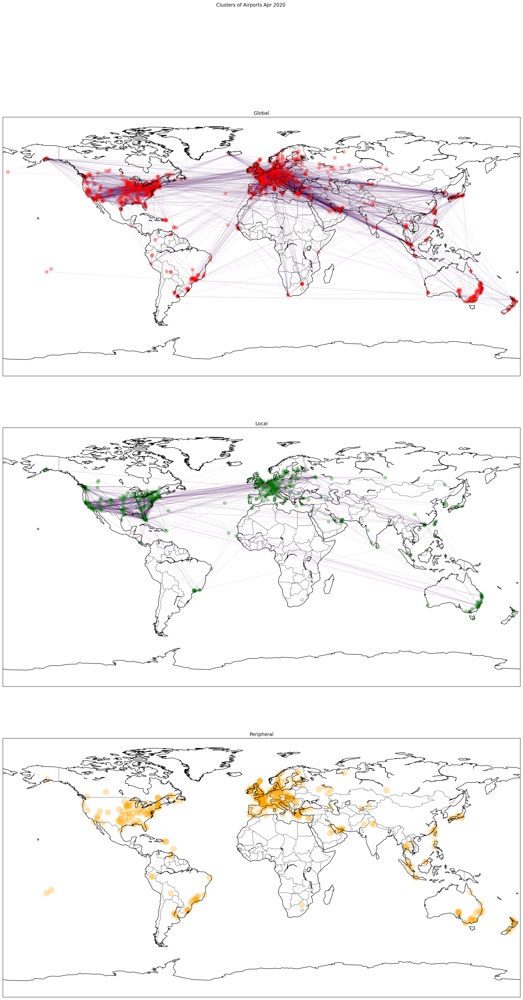

In [17]:
nodes_peri_2020, nodes_local_2020, nodes_global_2020 = draw_cluster_and_get_nodes_list(g_2020_apr,'Apr 2020',True)

# 4 Perform a t-core decomposition to the graph

## 4.1 Define function for t-core Analysis

In [18]:
# Instead of removing the node from graph, we add an attribute to it called t_layer, then everytime we examine the nodes that
# are not assigned a layer yet
def remove_t_layer_node(g, t):
    t_layer_nodes = []
    for n_i in g:
        # Find out nodes that are still not assigned a layer
        t_layer_attri = nx.get_node_attributes(g, 't_layer')
        unassigned_nodes = [x for x,_ in g.nodes(data=True) if x not in t_layer_attri]
        # We don't have to deal with n_i if it is already assigned a layer
        if n_i in unassigned_nodes:
            # Get number of triangles that current node is involved
            n_triangles = nx.triangles(g.subgraph(unassigned_nodes), n_i)

            # If current node is t_layer node, we add it to result and examine further if after removal there are more t_layer nodes exposed
            if n_triangles <= t:
                sys.stdout.flush()
                sys.stdout.write('\r')
                sys.stdout.flush()
                sys.stdout.write(f"Removing: {n_i}")
                t_layer_nodes.append(n_i)
                nx.set_node_attributes(g, {n_i: t}, "t_layer")
                recur_t_layer_nodes, g = remove_t_layer_node(g, t)
                t_layer_nodes += recur_t_layer_nodes       
    return t_layer_nodes, g

In [21]:
def t_core_decomposition(g):
    result = {}
    # t_index is the current t_layer to be assigned
    t_index = 0
    while len(nx.get_node_attributes(g, 't_layer')) < g.number_of_nodes() != 0:                    
        print(f"\nCurrent layer {t_index}, {len(nx.get_node_attributes(g, 't_layer'))} of {g.number_of_nodes()} nodes assigned")
        t_layer_nodes, g = remove_t_layer_node(g, t_index)
        result[t_index] = t_layer_nodes
        t_index += 1 
    return result
layer_nodes = t_core_decomposition(g_2019)


Current layer 0, 0 of 1590 nodes assigned
Removing: ZYHE
Current layer 1, 308 of 1590 nodes assigned
Removing: YTGA
Current layer 2, 424 of 1590 nodes assigned
Removing: SBVG
Current layer 3, 460 of 1590 nodes assigned
Removing: YTMU
Current layer 4, 531 of 1590 nodes assigned
Removing: YNRM
Current layer 5, 551 of 1590 nodes assigned
Removing: YSPE
Current layer 6, 583 of 1590 nodes assigned
Removing: YIVLRemoving: SADP
Current layer 7, 618 of 1590 nodes assigned
Removing: RKTU
Current layer 8, 632 of 1590 nodes assigned
Removing: YTRE
Current layer 9, 649 of 1590 nodes assigned
Removing: YYNG
Current layer 10, 674 of 1590 nodes assigned
Removing: YOLA
Current layer 11, 698 of 1590 nodes assigned
Removing: YNBR
Current layer 12, 703 of 1590 nodes assigned
Removing: LFJR
Current layer 13, 710 of 1590 nodes assigned
Removing: YWGT
Current layer 14, 720 of 1590 nodes assigned
Removing: YWCH
Current layer 15, 738 of 1590 nodes assigned
Removing: YWND
Current layer 16, 753 of 1590 nodes a

Removing: KAKR
Current layer 142, 1071 of 1590 nodes assigned

Current layer 143, 1071 of 1590 nodes assigned
Removing: LEJR
Current layer 144, 1073 of 1590 nodes assigned
Removing: KFAY
Current layer 145, 1074 of 1590 nodes assigned

Current layer 146, 1074 of 1590 nodes assigned
Removing: OEDR
Current layer 147, 1079 of 1590 nodes assigned
Removing: KALO
Current layer 148, 1080 of 1590 nodes assigned
Removing: LFPC
Current layer 149, 1081 of 1590 nodes assigned
Removing: LSZC
Current layer 150, 1086 of 1590 nodes assigned
Removing: SBKP
Current layer 151, 1087 of 1590 nodes assigned

Current layer 152, 1087 of 1590 nodes assigned

Current layer 153, 1087 of 1590 nodes assigned

Current layer 154, 1087 of 1590 nodes assigned
Removing: WMSA
Current layer 155, 1088 of 1590 nodes assigned
Removing: KSLK
Current layer 156, 1091 of 1590 nodes assigned

Current layer 157, 1091 of 1590 nodes assigned
Removing: LIMZ
Current layer 158, 1092 of 1590 nodes assigned
Removing: CYTZ
Current layer 1

Removing: EGNR
Current layer 295, 1174 of 1590 nodes assigned
Removing: LLSD
Current layer 296, 1175 of 1590 nodes assigned

Current layer 297, 1175 of 1590 nodes assigned
Removing: GBYD
Current layer 298, 1178 of 1590 nodes assigned
Removing: LOWG
Current layer 299, 1180 of 1590 nodes assigned
Removing: MMTJ
Current layer 300, 1181 of 1590 nodes assigned

Current layer 301, 1181 of 1590 nodes assigned

Current layer 302, 1181 of 1590 nodes assigned
Removing: KBVY
Current layer 303, 1182 of 1590 nodes assigned

Current layer 304, 1182 of 1590 nodes assigned

Current layer 305, 1182 of 1590 nodes assigned

Current layer 306, 1182 of 1590 nodes assigned

Current layer 307, 1182 of 1590 nodes assigned

Current layer 308, 1182 of 1590 nodes assigned

Current layer 309, 1182 of 1590 nodes assigned

Current layer 310, 1182 of 1590 nodes assigned
Removing: EGNV
Current layer 311, 1183 of 1590 nodes assigned

Current layer 312, 1183 of 1590 nodes assigned
Removing: OEDF
Current layer 313, 1184


Current layer 453, 1242 of 1590 nodes assigned

Current layer 454, 1242 of 1590 nodes assigned

Current layer 455, 1242 of 1590 nodes assigned
Removing: KCDW
Current layer 456, 1244 of 1590 nodes assigned
Removing: KLAF
Current layer 457, 1249 of 1590 nodes assigned

Current layer 458, 1249 of 1590 nodes assigned

Current layer 459, 1249 of 1590 nodes assigned
Removing: KCCR
Current layer 460, 1253 of 1590 nodes assigned

Current layer 461, 1253 of 1590 nodes assigned

Current layer 462, 1253 of 1590 nodes assigned

Current layer 463, 1253 of 1590 nodes assigned

Current layer 464, 1253 of 1590 nodes assigned
Removing: FACT
Current layer 465, 1256 of 1590 nodes assigned
Removing: OMAM
Current layer 466, 1257 of 1590 nodes assigned

Current layer 467, 1257 of 1590 nodes assigned

Current layer 468, 1257 of 1590 nodes assigned

Current layer 469, 1257 of 1590 nodes assigned

Current layer 470, 1257 of 1590 nodes assigned

Current layer 471, 1257 of 1590 nodes assigned

Current layer 472


Current layer 614, 1298 of 1590 nodes assigned
Removing: KHSV
Current layer 615, 1299 of 1590 nodes assigned

Current layer 616, 1299 of 1590 nodes assigned

Current layer 617, 1299 of 1590 nodes assigned

Current layer 618, 1299 of 1590 nodes assigned

Current layer 619, 1299 of 1590 nodes assigned

Current layer 620, 1299 of 1590 nodes assigned

Current layer 621, 1299 of 1590 nodes assigned

Current layer 622, 1299 of 1590 nodes assigned

Current layer 623, 1299 of 1590 nodes assigned

Current layer 624, 1299 of 1590 nodes assigned
Removing: LOWI
Current layer 625, 1300 of 1590 nodes assigned

Current layer 626, 1300 of 1590 nodes assigned

Current layer 627, 1300 of 1590 nodes assigned

Current layer 628, 1300 of 1590 nodes assigned

Current layer 629, 1300 of 1590 nodes assigned

Current layer 630, 1300 of 1590 nodes assigned

Current layer 631, 1300 of 1590 nodes assigned

Current layer 632, 1300 of 1590 nodes assigned

Current layer 633, 1300 of 1590 nodes assigned

Current lay

Removing: KSGF
Current layer 780, 1327 of 1590 nodes assigned

Current layer 781, 1327 of 1590 nodes assigned
Removing: LIRP
Current layer 782, 1330 of 1590 nodes assigned

Current layer 783, 1330 of 1590 nodes assigned

Current layer 784, 1330 of 1590 nodes assigned

Current layer 785, 1330 of 1590 nodes assigned

Current layer 786, 1330 of 1590 nodes assigned

Current layer 787, 1330 of 1590 nodes assigned

Current layer 788, 1330 of 1590 nodes assigned

Current layer 789, 1330 of 1590 nodes assigned

Current layer 790, 1330 of 1590 nodes assigned

Current layer 791, 1330 of 1590 nodes assigned

Current layer 792, 1330 of 1590 nodes assigned
Removing: KFWA
Current layer 793, 1331 of 1590 nodes assigned

Current layer 794, 1331 of 1590 nodes assigned
Removing: LFLS
Current layer 795, 1332 of 1590 nodes assigned
Removing: KPUB
Current layer 796, 1334 of 1590 nodes assigned
Removing: MMUN
Current layer 797, 1335 of 1590 nodes assigned
Removing: LFLY
Current layer 798, 1337 of 1590 nodes


Current layer 945, 1358 of 1590 nodes assigned

Current layer 946, 1358 of 1590 nodes assigned

Current layer 947, 1358 of 1590 nodes assigned

Current layer 948, 1358 of 1590 nodes assigned

Current layer 949, 1358 of 1590 nodes assigned

Current layer 950, 1358 of 1590 nodes assigned

Current layer 951, 1358 of 1590 nodes assigned

Current layer 952, 1358 of 1590 nodes assigned

Current layer 953, 1358 of 1590 nodes assigned

Current layer 954, 1358 of 1590 nodes assigned

Current layer 955, 1358 of 1590 nodes assigned

Current layer 956, 1358 of 1590 nodes assigned
Removing: EDSB
Current layer 957, 1359 of 1590 nodes assigned

Current layer 958, 1359 of 1590 nodes assigned

Current layer 959, 1359 of 1590 nodes assigned

Current layer 960, 1359 of 1590 nodes assigned

Current layer 961, 1359 of 1590 nodes assigned

Current layer 962, 1359 of 1590 nodes assigned

Current layer 963, 1359 of 1590 nodes assigned

Current layer 964, 1359 of 1590 nodes assigned

Current layer 965, 1359 o


Current layer 1108, 1397 of 1590 nodes assigned

Current layer 1109, 1397 of 1590 nodes assigned

Current layer 1110, 1397 of 1590 nodes assigned

Current layer 1111, 1397 of 1590 nodes assigned

Current layer 1112, 1397 of 1590 nodes assigned
Removing: LRBS
Current layer 1113, 1399 of 1590 nodes assigned

Current layer 1114, 1399 of 1590 nodes assigned

Current layer 1115, 1399 of 1590 nodes assigned

Current layer 1116, 1399 of 1590 nodes assigned

Current layer 1117, 1399 of 1590 nodes assigned

Current layer 1118, 1399 of 1590 nodes assigned

Current layer 1119, 1399 of 1590 nodes assigned

Current layer 1120, 1399 of 1590 nodes assigned

Current layer 1121, 1399 of 1590 nodes assigned

Current layer 1122, 1399 of 1590 nodes assigned

Current layer 1123, 1399 of 1590 nodes assigned

Current layer 1124, 1399 of 1590 nodes assigned

Current layer 1125, 1399 of 1590 nodes assigned

Current layer 1126, 1399 of 1590 nodes assigned

Current layer 1127, 1399 of 1590 nodes assigned
Removi

In [22]:
# Helper function which combines all nodes within t_min and t_max
def get_node_list_by_t_value(nodes_dict, t_min, t_max):
    result = []
    for k, v in nodes_dict.items():
        if k >= t_min and k <= t_max:
            result += v
    return result

## 4.2 Dec 2019 core, bridge, peripheral by t-core

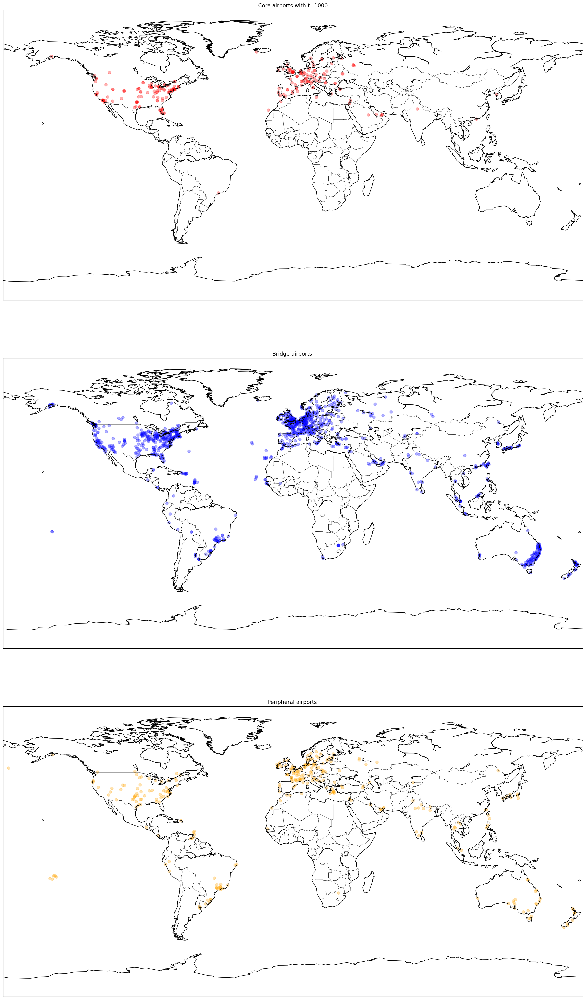

In [23]:
fig, axs = plt.subplots(3,figsize = (30,40), dpi=200)
axs[0].set_title("Core airports with t=1000")
axs[1].set_title("Bridge airports ")
axs[2].set_title("Peripheral airports ")
draw_flights_on_map(g_2019.subgraph(get_node_list_by_t_value(layer_nodes, 1000, max(layer_nodes.keys()))),axs[0], draw_edge=False, node_size=40)
draw_flights_on_map(g_2019.subgraph(layer_nodes[0]),axs[2], node_size=40,node_color='orange')
draw_flights_on_map(g_2019.subgraph(get_node_list_by_t_value(layer_nodes, 1, 999)),axs[1], draw_edge=False, node_size=40, node_color='blue')

In [24]:
layer_nodes_2020 = t_core_decomposition(g_2020_apr)


Current layer 0, 0 of 1474 nodes assigned
Removing: ZSAM
Current layer 1, 382 of 1474 nodes assigned
Removing: YWGT
Current layer 2, 539 of 1474 nodes assigned
Removing: YQDI
Current layer 3, 595 of 1474 nodes assigned
Removing: YFST
Current layer 4, 659 of 1474 nodes assigned
Removing: YCTM
Current layer 5, 700 of 1474 nodes assigned
Removing: WBKL
Current layer 6, 730 of 1474 nodes assigned
Removing: YTMU
Current layer 7, 784 of 1474 nodes assigned
Removing: YMES
Current layer 8, 800 of 1474 nodes assigned
Removing: RCKH
Current layer 9, 812 of 1474 nodes assigned
Removing: YBNS
Current layer 10, 831 of 1474 nodes assigned
Removing: YWND
Current layer 11, 841 of 1474 nodes assigned
Removing: LOWK
Current layer 12, 854 of 1474 nodes assigned
Removing: SDAM
Current layer 13, 869 of 1474 nodes assigned
Removing: YGDH
Current layer 14, 879 of 1474 nodes assigned
Removing: YMMB
Current layer 15, 889 of 1474 nodes assigned
Removing: YGFN
Current layer 16, 905 of 1474 nodes assigned
Removi

Removing: EETN
Current layer 143, 1211 of 1474 nodes assigned
Removing: LEZG
Current layer 144, 1213 of 1474 nodes assigned
Removing: KJQF
Current layer 145, 1214 of 1474 nodes assigned

Current layer 146, 1214 of 1474 nodes assigned

Current layer 147, 1214 of 1474 nodes assigned
Removing: VCBI
Current layer 148, 1217 of 1474 nodes assigned

Current layer 149, 1217 of 1474 nodes assigned

Current layer 150, 1217 of 1474 nodes assigned

Current layer 151, 1217 of 1474 nodes assigned

Current layer 152, 1217 of 1474 nodes assigned

Current layer 153, 1217 of 1474 nodes assigned
Removing: LPFR
Current layer 154, 1218 of 1474 nodes assigned

Current layer 155, 1218 of 1474 nodes assigned

Current layer 156, 1218 of 1474 nodes assigned

Current layer 157, 1218 of 1474 nodes assigned

Current layer 158, 1218 of 1474 nodes assigned
Removing: EGPK
Current layer 159, 1219 of 1474 nodes assigned

Current layer 160, 1219 of 1474 nodes assigned

Current layer 161, 1219 of 1474 nodes assigned

Cur


Current layer 300, 1311 of 1474 nodes assigned

Current layer 301, 1311 of 1474 nodes assigned

Current layer 302, 1311 of 1474 nodes assigned

Current layer 303, 1311 of 1474 nodes assigned

Current layer 304, 1311 of 1474 nodes assigned

Current layer 305, 1311 of 1474 nodes assigned

Current layer 306, 1311 of 1474 nodes assigned

Current layer 307, 1311 of 1474 nodes assigned
Removing: KTTN
Current layer 308, 1312 of 1474 nodes assigned

Current layer 309, 1312 of 1474 nodes assigned

Current layer 310, 1312 of 1474 nodes assigned

Current layer 311, 1312 of 1474 nodes assigned
Removing: EFHK
Current layer 312, 1313 of 1474 nodes assigned

Current layer 313, 1313 of 1474 nodes assigned

Current layer 314, 1313 of 1474 nodes assigned

Current layer 315, 1313 of 1474 nodes assigned

Current layer 316, 1313 of 1474 nodes assigned

Current layer 317, 1313 of 1474 nodes assigned

Current layer 318, 1313 of 1474 nodes assigned

Current layer 319, 1313 of 1474 nodes assigned

Current lay


Current layer 466, 1396 of 1474 nodes assigned

Current layer 467, 1396 of 1474 nodes assigned

Current layer 468, 1396 of 1474 nodes assigned

Current layer 469, 1396 of 1474 nodes assigned

Current layer 470, 1396 of 1474 nodes assigned

Current layer 471, 1396 of 1474 nodes assigned

Current layer 472, 1396 of 1474 nodes assigned

Current layer 473, 1396 of 1474 nodes assigned

Current layer 474, 1396 of 1474 nodes assigned

Current layer 475, 1396 of 1474 nodes assigned

Current layer 476, 1396 of 1474 nodes assigned

Current layer 477, 1396 of 1474 nodes assigned

Current layer 478, 1396 of 1474 nodes assigned

Current layer 479, 1396 of 1474 nodes assigned

Current layer 480, 1396 of 1474 nodes assigned

Current layer 481, 1396 of 1474 nodes assigned

Current layer 482, 1396 of 1474 nodes assigned

Current layer 483, 1396 of 1474 nodes assigned

Current layer 484, 1396 of 1474 nodes assigned
Removing: KSMF
Current layer 485, 1397 of 1474 nodes assigned
Removing: KGSO
Current lay

## 4.3 Apr 2020 core, bridge, peripheral by t-core

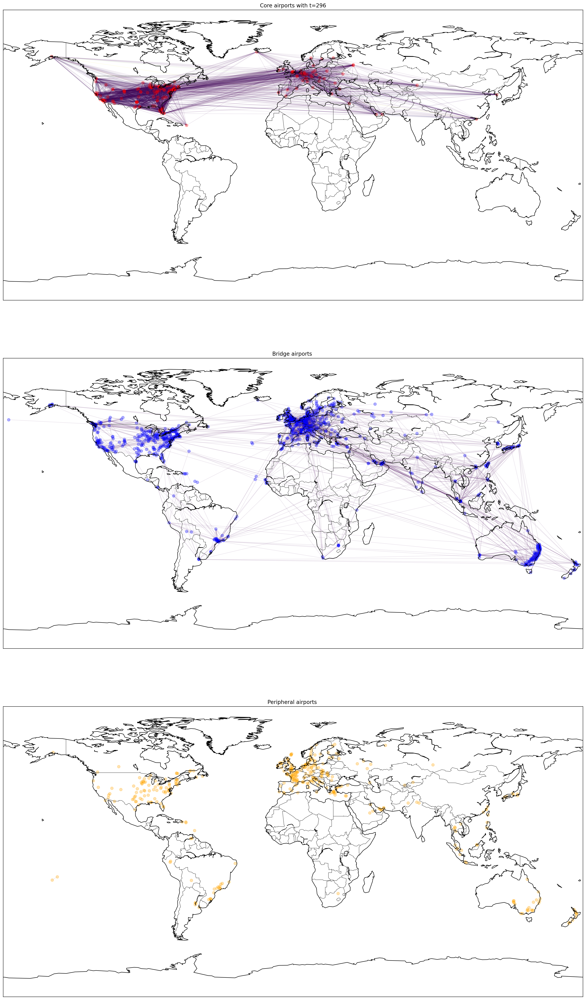

In [25]:
fig, axs = plt.subplots(3,figsize = (30,40), dpi=200)
axs[0].set_title("Core airports with t=296")
axs[1].set_title("Bridge airports ")
axs[2].set_title("Peripheral airports ")
draw_flights_on_map(g_2020_apr.subgraph(get_node_list_by_t_value(layer_nodes_2020, 296, max(layer_nodes_2020.keys()))),axs[0], draw_edge=True, node_size=40)
draw_flights_on_map(g_2020_apr.subgraph(layer_nodes_2020[0]),axs[2], node_size=40,node_color='orange')
draw_flights_on_map(g_2020_apr.subgraph(get_node_list_by_t_value(layer_nodes_2020, 1, 295)),axs[1], draw_edge=True, node_size=40, node_color='blue')

In [26]:
29*15*4

1740

# 5 Connectivity and Robustness Analysis

## 5.1 Nodes attack

In [27]:
def delete_random_elems(input_list, n):
    to_delete = set(random.sample(range(len(input_list)), n))
    return [x for i,x in enumerate(input_list) if i in to_delete]

def high_deg(graph):
    l_high = []
    nodes_list = sorted(graph.degree(), key=lambda x: x[1], reverse=True)
    for node in nodes_list:
        l_high.append(node[0])
    return l_high

def low_deg(graph):
    l_low = []
    nodes_list = sorted(graph.degree(), key=lambda x: x[1])
    for node in nodes_list:
        l_low.append(node[0])
    return l_low

def LCC_vs_removal_nodes(removed_fraction, file_name, typ):
    # Average fraction of nodes as a function of removed nodes
    g = nx.read_gml(file_name)
    
    nodes_count = nx.number_of_nodes(g)
    nodes_list = list(g.nodes())
    random.shuffle(nodes_list)

    high_19_dec = high_deg(g)
    high_20_apr = high_deg(g)
    low_19_dec = low_deg(g)
    low_20_apr = low_deg(g)
    # high_19_dec = get_node_list_by_t_value(layer_nodes, 1000, max(layer_nodes.keys())).copy()
    # high_20_apr = get_node_list_by_t_value(layer_nodes_2020, 296, max(layer_nodes_2020.keys())).copy()
    # peri_19_dec = get_node_list_by_t_value(layer_nodes, 1, 999).copy()
    # peri_20_apr = get_node_list_by_t_value(layer_nodes_2020, 1, 295).copy()
    NG = []
    #C = []

    for i in removed_fraction:

        if typ == "random":
            # Random remove
            
            g.remove_nodes_from(nodes_list[:int(i * nodes_count)])
            #print(len(delete_random_elems(nodes_dec_19, int(i * len(nodes_dec_19)))))
        elif typ == "high":
            # remove important (high degree) nodes
            if file_name == "flightlist_20191201_20191231.gml":
                g.remove_nodes_from(high_19_dec[:int(i * nodes_count)])
            else:
                g.remove_nodes_from(high_20_apr[:int(i * nodes_count)])
        else:
            if file_name == "flightlist_20191201_20191231.gml":
                g.remove_nodes_from(low_19_dec[:int(i * nodes_count)])
            else:
                g.remove_nodes_from(low_20_apr[:int(i * nodes_count)])          

        tmp_NG = []
        print("Remaining nodes: " + str(nx.number_of_nodes(g)))

        for j in range(501):
            # Largest Connected Component
            tmp_NG.append(len(max([c for c in nx.connected_components(g)],key=len))/nodes_count)
            #tmp_C.append(nx.average_clustering(g_2019))

        NG.append(sum(tmp_NG)/len(tmp_NG))
        #C.append(sum(tmp_C)/len(tmp_C))
    print("-------------------------")
    return NG

In [28]:
removed_fraction_nodes = []
frac = 0

while frac <= 1:
    removed_fraction_nodes.append(frac)
    frac = frac + 0.02

random_NG_2019_dec = []
random_NG_2020_apr = []

high_NG_2019_dec = []
high_NG_2020_apr = []

low_NG_2019_dec = []
low_NG_2020_apr = []

random_NG_2019_dec = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20191201_20191231.gml", "random")
random_NG_2020_apr = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20200401_20200430.gml", "random")
high_NG_2019_dec = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20191201_20191231.gml", "high")
high_NG_2020_apr = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20200401_20200430.gml", "high")
low_NG_2019_dec = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20191201_20191231.gml", "low")
low_NG_2020_apr = LCC_vs_removal_nodes(removed_fraction_nodes, "flightlist_20200401_20200430.gml", "low")

Remaining nodes: 1590
Remaining nodes: 1559
Remaining nodes: 1527
Remaining nodes: 1495
Remaining nodes: 1463
Remaining nodes: 1431
Remaining nodes: 1400
Remaining nodes: 1368
Remaining nodes: 1336
Remaining nodes: 1304
Remaining nodes: 1272
Remaining nodes: 1241
Remaining nodes: 1209
Remaining nodes: 1177
Remaining nodes: 1145
Remaining nodes: 1113
Remaining nodes: 1082
Remaining nodes: 1050
Remaining nodes: 1018
Remaining nodes: 986
Remaining nodes: 954
Remaining nodes: 923
Remaining nodes: 891
Remaining nodes: 859
Remaining nodes: 827
Remaining nodes: 795
Remaining nodes: 764
Remaining nodes: 732
Remaining nodes: 700
Remaining nodes: 668
Remaining nodes: 636
Remaining nodes: 605
Remaining nodes: 573
Remaining nodes: 541
Remaining nodes: 509
Remaining nodes: 477
Remaining nodes: 446
Remaining nodes: 414
Remaining nodes: 382
Remaining nodes: 350
Remaining nodes: 318
Remaining nodes: 287
Remaining nodes: 255
Remaining nodes: 223
Remaining nodes: 191
Remaining nodes: 159
Remaining nodes

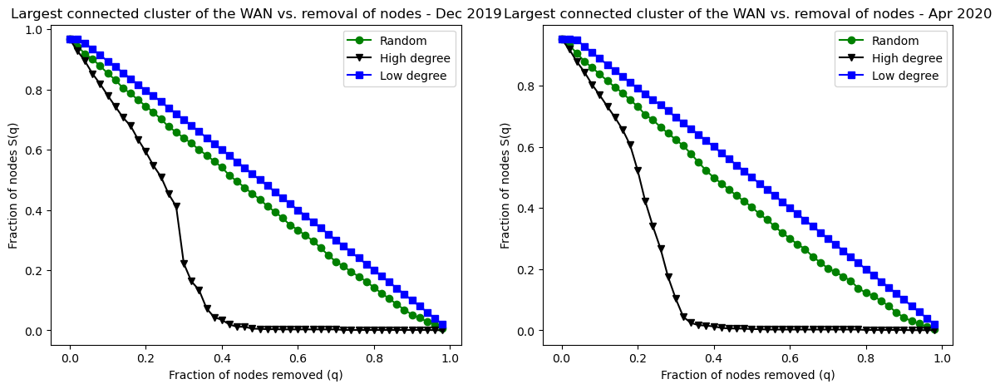

In [29]:
figure, axis = plt.subplots(1, 2, figsize=(14,5))

axis[0].plot(removed_fraction_nodes, random_NG_2019_dec, marker='o', label="Random",color = 'g')
axis[0].plot(removed_fraction_nodes, high_NG_2019_dec, marker='v', label="High degree",color = 'k')
axis[0].plot(removed_fraction_nodes, low_NG_2019_dec, marker='s', label="Low degree",color = 'b')
axis[0].set_title("Largest connected cluster of the WAN vs. removal of nodes - Dec 2019")
axis[0].set_xlabel("Fraction of nodes removed (q)")
axis[0].set_ylabel("Fraction of nodes S(q)")
axis[0].legend()
#axis[0].set_xscale("log")
#axis[0].set_yscale("log")

axis[1].plot(removed_fraction_nodes, random_NG_2020_apr, marker='o', label="Random", color = 'g')
axis[1].plot(removed_fraction_nodes, high_NG_2020_apr, marker='v', label="High degree", color = 'k')
axis[1].plot(removed_fraction_nodes, low_NG_2020_apr, marker='s', label="Low degree", color = 'b')
axis[1].set_title("Largest connected cluster of the WAN vs. removal of nodes - Apr 2020")
axis[1].set_xlabel("Fraction of nodes removed (q)")
axis[1].set_ylabel("Fraction of nodes S(q)")
# axis[1].set_xscale("log")
# axis[1].set_yscale("log")
axis[1].legend()

plt.show()

## 5.2 Edges Attack

In [30]:
def delete_random_elems(input_list, n):
    to_delete = set(random.sample(range(len(input_list)), n))
    return [x for i,x in enumerate(input_list) if i in to_delete]

def high_traffic(graph):
    l_high = []
    edges_list = sorted(graph.edges(data=True), key=lambda t: t[2].get('value', 1), reverse=True)
    for edge in edges_list:
        l_high.append((edge[0], edge[1]))
    return l_high

def low_traffic(graph):
    l_low = []
    edges_list = sorted(graph.edges(data=True), key=lambda t: t[2].get('value', 1))
    for edge in edges_list:
        l_low.append((edge[0], edge[1]))
    return l_low

def LCC_vs_removal_links(removed_fraction, file_name, typ):
    # Average fraction of nodes as a function of removed nodes
    g = nx.read_gml(file_name)
    
    edges_count = nx.number_of_edges(g)
    edges_list = list(g.edges())
    random.shuffle(edges_list)

    high_19_dec = high_traffic(g)
    high_20_apr = high_traffic(g)
    low_19_dec = low_traffic(g)
    low_20_apr = low_traffic(g)
 
    NG = []
    #C = []

    for i in removed_fraction:

        if typ == "random":
            # Random remove
            
            g.remove_edges_from(edges_list[:int(i * edges_count)])
            #print(len(delete_random_elems(nodes_dec_19, int(i * len(nodes_dec_19)))))
        elif typ == "high":
            # remove important (high degree) nodes
            if file_name == "flightlist_20191201_20191231.gml":
                g.remove_edges_from(high_19_dec[:int(i * edges_count)])
            else:
                g.remove_edges_from(high_20_apr[:int(i * edges_count)])
        else:
            if file_name == "flightlist_20191201_20191231.gml":
                g.remove_edges_from(low_19_dec[:int(i * edges_count)])
            else:
                g.remove_edges_from(low_20_apr[:int(i * edges_count)])          

        tmp_NG = []
        print("Remaining edges: " + str(nx.number_of_edges(g)))

        for j in range(501):
            # Largest Connected Component
            tmp_NG.append(len(max([c for c in nx.connected_components(g)],key=len))/nx.number_of_nodes(g))
            #tmp_C.append(nx.average_clustering(g_2019))

        NG.append(sum(tmp_NG)/len(tmp_NG))
        #C.append(sum(tmp_C)/len(tmp_C))
    print("-------------------------")
    return NG

In [31]:
removed_fraction_edges = []
frac = 0

while frac <= 1:
    removed_fraction_edges.append(frac)
    frac = frac + 0.02

random_NG_2019_dec = []
random_NG_2020_apr = []

high_NG_2019_dec = []
high_NG_2020_apr = []

low_NG_2019_dec = []
low_NG_2020_apr = []

random_NG_2019_dec = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "random")
random_NG_2020_apr = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "random")
high_NG_2019_dec = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "high")
high_NG_2020_apr = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "high")
low_NG_2019_dec = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "low")
low_NG_2020_apr = LCC_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "low")

Remaining edges: 26135
Remaining edges: 25613
Remaining edges: 25090
Remaining edges: 24567
Remaining edges: 24045
Remaining edges: 23522
Remaining edges: 22999
Remaining edges: 22477
Remaining edges: 21954
Remaining edges: 21431
Remaining edges: 20908
Remaining edges: 20386
Remaining edges: 19863
Remaining edges: 19340
Remaining edges: 18818
Remaining edges: 18295
Remaining edges: 17772
Remaining edges: 17250
Remaining edges: 16727
Remaining edges: 16204
Remaining edges: 15681
Remaining edges: 15159
Remaining edges: 14636
Remaining edges: 14113
Remaining edges: 13591
Remaining edges: 13068
Remaining edges: 12545
Remaining edges: 12023
Remaining edges: 11500
Remaining edges: 10977
Remaining edges: 10454
Remaining edges: 9932
Remaining edges: 9409
Remaining edges: 8886
Remaining edges: 8364
Remaining edges: 7841
Remaining edges: 7318
Remaining edges: 6796
Remaining edges: 6273
Remaining edges: 5750
Remaining edges: 5227
Remaining edges: 4705
Remaining edges: 4182
Remaining edges: 3659
R

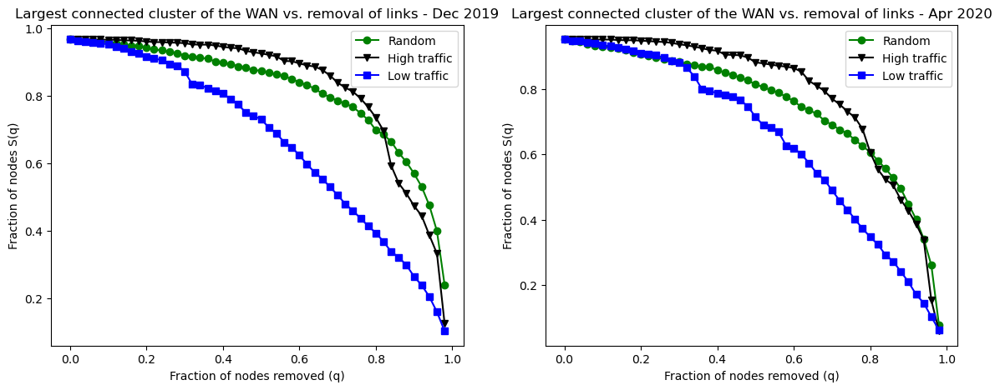

In [32]:
figure, axis = plt.subplots(1, 2, figsize=(14,5))

axis[0].plot(removed_fraction_edges, random_NG_2019_dec, marker='o', label="Random",color = 'g')
axis[0].plot(removed_fraction_edges, high_NG_2019_dec, marker='v', label="High traffic",color = 'k')
axis[0].plot(removed_fraction_edges, low_NG_2019_dec, marker='s', label="Low traffic",color = 'b')
axis[0].set_title("Largest connected cluster of the WAN vs. removal of links - Dec 2019")
axis[0].set_xlabel("Fraction of nodes removed (q)")
axis[0].set_ylabel("Fraction of nodes S(q)")
axis[0].legend()
#axis[0].set_xscale("log")
#axis[0].set_yscale("log")

axis[1].plot(removed_fraction_edges, random_NG_2020_apr, marker='o', label="Random", color = 'g')
axis[1].plot(removed_fraction_edges, high_NG_2020_apr, marker='v', label="High traffic", color = 'k')
axis[1].plot(removed_fraction_edges, low_NG_2020_apr, marker='s', label="Low traffic", color = 'b')
axis[1].set_title("Largest connected cluster of the WAN vs. removal of links - Apr 2020")
axis[1].set_xlabel("Fraction of nodes removed (q)")
axis[1].set_ylabel("Fraction of nodes S(q)")
# axis[1].set_xscale("log")
# axis[1].set_yscale("log")
axis[1].legend()

plt.show()

## 5.3 Clustering attack

In [33]:
def drop_airport(largest_component, nodes_category):
    remained_airport = []

    for airport in nodes_category:
        if airport in largest_component:
            remained_airport.append(airport)

    return len(remained_airport)

def drop_air_vs_removal_links(removed_fraction, file_name, typ, nodes_peri, nodes_global, nodes_local):
    # Average fraction of nodes as a function of removed nodes
    g = nx.read_gml(file_name)
    
    edges_count = nx.number_of_edges(g)
    edges_list = list(g.edges())
    random.shuffle(edges_list)

    if typ == "high":
        links= high_traffic(g)
    elif typ == "low":
        links = low_traffic(g)

    drop_peri = []
    drop_global = []
    drop_local = []

    for i in removed_fraction:
        if typ == "random":
            # Random remove
            
            g.remove_edges_from(edges_list[:int(i * edges_count)])
            #print(len(delete_random_elems(nodes_dec_19, int(i * len(nodes_dec_19)))))
        else:
            g.remove_edges_from(links[:int(i * edges_count)])       

        tmp_drop_peri = []
        tmp_drop_global = []
        tmp_drop_local = []
        #print("Remaining edges: " + str(nx.number_of_edges(g)))

        for j in range(50):
            # Largest Connected Component
            largest_component = max([c for c in nx.connected_components(g)],key=len) 
            tmp_drop_peri.append(drop_airport(largest_component, nodes_peri))
            tmp_drop_global.append(drop_airport(largest_component, nodes_global))
            tmp_drop_local.append(drop_airport(largest_component, nodes_local))
               
        drop_peri.append((sum(tmp_drop_peri)/len(tmp_drop_peri))/len(nodes_peri))
        drop_global.append((sum(tmp_drop_global)/len(tmp_drop_global))/len(nodes_global))
        drop_local.append((sum(tmp_drop_local)/len(tmp_drop_local))/len(nodes_local))

    print("Finished 1 dataset")
    return drop_peri, drop_global, drop_local 

In [34]:
removed_fraction_edges = []
frac = 0

while frac <= 1:
    removed_fraction_edges.append(frac)
    frac = frac + 0.02

random_NG_peri_2019 = []
random_NG_global_2019 = []
random_NG_local_2019 =[]

high_NG_peri_2019 = []
high_NG_global_2019 = []
high_NG_local_2019 = []

low_NG_peri_2019 = []
low_NG_global_2019 = []
low_NG_local_2019 = []

random_NG_peri_2019, random_NG_global_2019, random_NG_local_2019 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "random", nodes_peri_2019, nodes_global_2019, nodes_local_2019)
high_NG_peri_2019, high_NG_global_2019, high_NG_local_2019 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "high",nodes_peri_2019, nodes_global_2019, nodes_local_2019)
low_NG_peri_2019, low_NG_global_2019, low_NG_local_2019 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20191201_20191231.gml", "low",nodes_peri_2019, nodes_global_2019, nodes_local_2019)

Finished 1 dataset
Finished 1 dataset
Finished 1 dataset


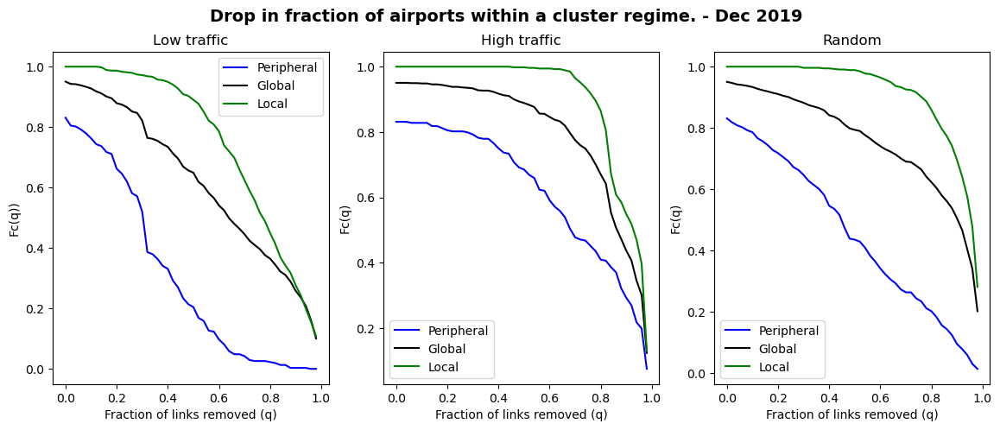

In [35]:
figure, axis = plt.subplots(1, 3, figsize=(14,5))

axis[2].plot(removed_fraction_edges, random_NG_peri_2019, label="Peripheral",color = 'b')
axis[2].plot(removed_fraction_edges, random_NG_global_2019, label="Global",color = 'k')
axis[2].plot(removed_fraction_edges, random_NG_local_2019, label="Local",color = 'g')
axis[2].set_title("Random")
axis[2].set_xlabel("Fraction of links removed (q)")
axis[2].set_ylabel("Fc(q)")
axis[2].legend()
#axis[0].set_xscale("log")
#axis[0].set_yscale("log")

axis[1].plot(removed_fraction_edges, high_NG_peri_2019,  label="Peripheral", color = 'b')
axis[1].plot(removed_fraction_edges, high_NG_global_2019, label="Global", color = 'k')
axis[1].plot(removed_fraction_edges, high_NG_local_2019, label="Local", color = 'g')
axis[1].set_title("High traffic")
axis[1].set_xlabel("Fraction of links removed (q)")
axis[1].set_ylabel("Fc(q)")
# # axis[1].set_xscale("log")
# # axis[1].set_yscale("log")
axis[1].legend()

axis[0].plot(removed_fraction_edges, low_NG_peri_2019, label="Peripheral", color = 'b')
axis[0].plot(removed_fraction_edges, low_NG_global_2019, label="Global", color = 'k')
axis[0].plot(removed_fraction_edges, low_NG_local_2019,  label="Local", color = 'g')
axis[0].set_title("Low traffic")
axis[0].set_xlabel("Fraction of links removed (q)")
axis[0].set_ylabel("Fc(q))")
axis[0].legend()

figure.suptitle('Drop in fraction of airports within a cluster regime. - Dec 2019', fontsize=14, fontweight='bold')
plt.show()

In [36]:
random_NG_peri_2020 = []
random_NG_global_2020 = []
random_NG_local_2020 =[]

high_NG_peri_2020 = []
high_NG_global_2020 = []
high_NG_local_2020 = []

low_NG_peri_2020 = []
low_NG_global_2020 = []
low_NG_local_2020 = []

random_NG_peri_2020, random_NG_global_2020, random_NG_local_2020 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "random",nodes_peri_2020, nodes_global_2020, nodes_local_2020)
high_NG_peri_2020, high_NG_global_2020, high_NG_local_2020 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "high",nodes_peri_2020, nodes_global_2020, nodes_local_2020)
low_NG_peri_2020, low_NG_global_2020, low_NG_local_2020 = drop_air_vs_removal_links(removed_fraction_edges, "flightlist_20200401_20200430.gml", "low",nodes_peri_2020, nodes_global_2020, nodes_local_2020)

Finished 1 dataset
Finished 1 dataset
Finished 1 dataset


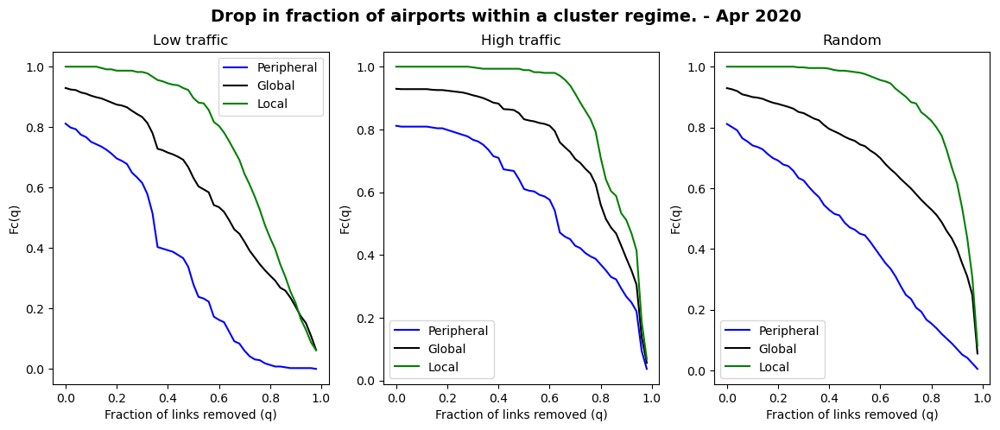

In [37]:
figure, axis = plt.subplots(1, 3, figsize=(14,5))

axis[2].plot(removed_fraction_edges, random_NG_peri_2020, label="Peripheral",color = 'b')
axis[2].plot(removed_fraction_edges, random_NG_global_2020, label="Global",color = 'k')
axis[2].plot(removed_fraction_edges, random_NG_local_2020, label="Local",color = 'g')
axis[2].set_title("Random")
axis[2].set_xlabel("Fraction of links removed (q)")
axis[2].set_ylabel("Fc(q)")
axis[2].legend()
#axis[0].set_xscale("log")
#axis[0].set_yscale("log")

axis[1].plot(removed_fraction_edges, high_NG_peri_2020,  label="Peripheral", color = 'b')
axis[1].plot(removed_fraction_edges, high_NG_global_2020, label="Global", color = 'k')
axis[1].plot(removed_fraction_edges, high_NG_local_2020, label="Local", color = 'g')
axis[1].set_title("High traffic")
axis[1].set_xlabel("Fraction of links removed (q)")
axis[1].set_ylabel("Fc(q)")
# # axis[1].set_xscale("log")
# # axis[1].set_yscale("log")
axis[1].legend()

axis[0].plot(removed_fraction_edges, low_NG_peri_2020, label="Peripheral", color = 'b')
axis[0].plot(removed_fraction_edges, low_NG_global_2020, label="Global", color = 'k')
axis[0].plot(removed_fraction_edges, low_NG_local_2020,  label="Local", color = 'g')
axis[0].set_title("Low traffic")
axis[0].set_xlabel("Fraction of links removed (q)")
axis[0].set_ylabel("Fc(q)")
axis[0].legend()

figure.suptitle('Drop in fraction of airports within a cluster regime. - Apr 2020', fontsize=14, fontweight='bold')
plt.show()